In [1]:
import numpy as np
import glob
import cv2
import matplotlib.pyplot as plt
from os import path as osp
from scipy.spatial import cKDTree
from sklearn.decomposition import PCA

from retrievalnet.settings import DATA_PATH, EXPER_PATH
from utils import plot_imgs
from retrievalnet.datasets.utils.nclt_undistort import Undistort
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
root = osp.join(DATA_PATH, 'datasets/nclt/')
exper_name = 'resnet50_delf_global-max-pool'
#exper_name = 'resnet50_imagenet_global-max-pool'
camera = 4
ref_seq = '2012-01-08'
query_seq = '2013-04-05'

In [3]:
def imread(seq, name):
    im = cv2.imread(osp.join(root, '{}/lb3/Cam{}/{}.tiff'.format(seq, camera, name)))
    return np.rot90(im, k=3)
def get_data(seq):
    im_poses = np.loadtxt(osp.join(root, 'pose_{}.csv'.format(seq)), 
                          dtype={'names': ('time', 'x', 'y', 'angle'),
                                 'formats': (np.int, np.float, np.float, np.float)},
                          delimiter=',', skiprows=1)
    descriptors = [np.load(osp.join(EXPER_PATH, 'outputs/{}/{}/{}.npz'.format(exper_name, seq, t)))['descriptor']
                   for t in im_poses['time']]
    return im_poses, descriptors
def norm(l):
    return [v/np.linalg.norm(v) for v in l]

In [4]:
ref_poses, ref_descriptors = get_data(ref_seq)
pca = PCA(n_components=40)
ref_descriptors_projected = pca.fit_transform(norm(ref_descriptors))
ref_tree = cKDTree(ref_descriptors_projected)

In [5]:
query_poses, query_descriptors = get_data(query_seq)
query_descriptors_projected = pca.transform(norm(query_descriptors))

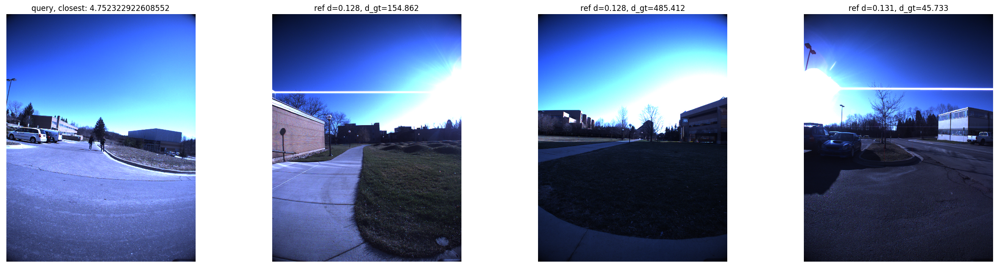

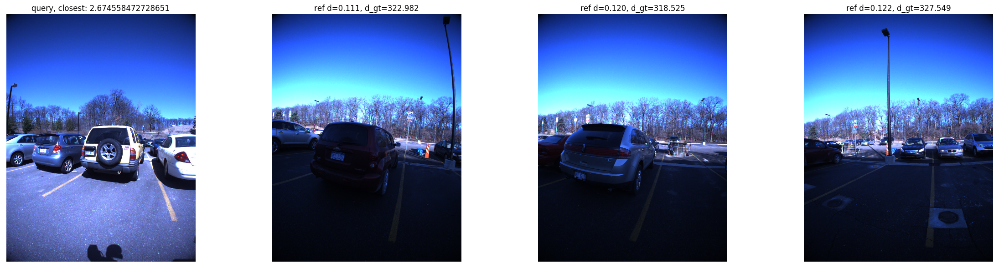

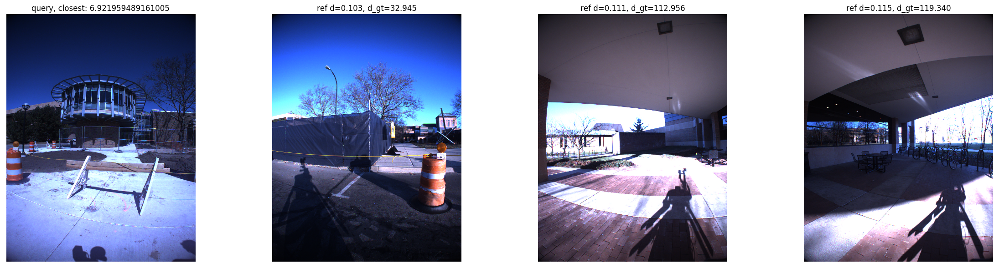

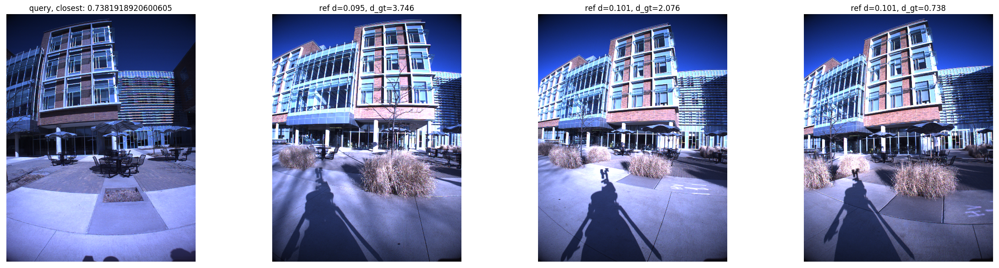

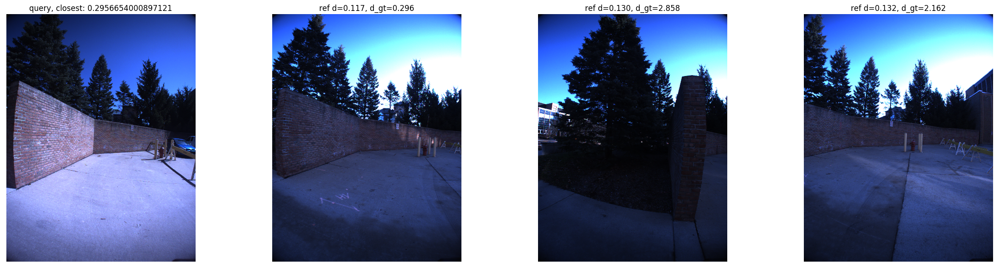

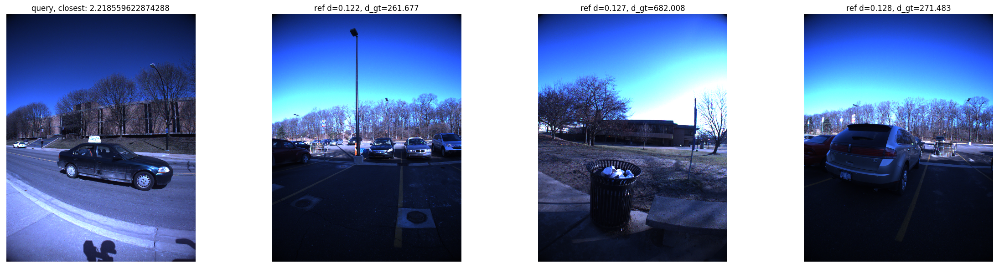

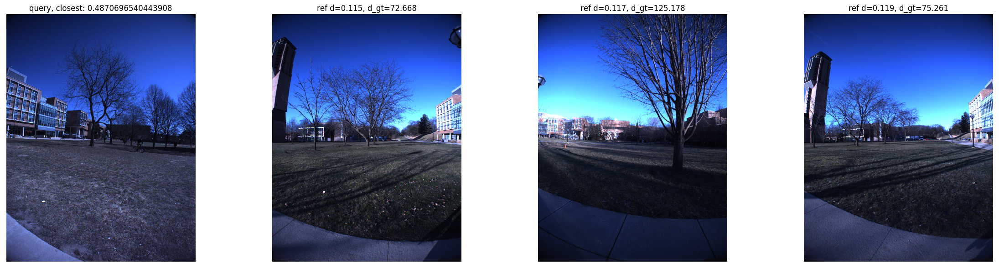

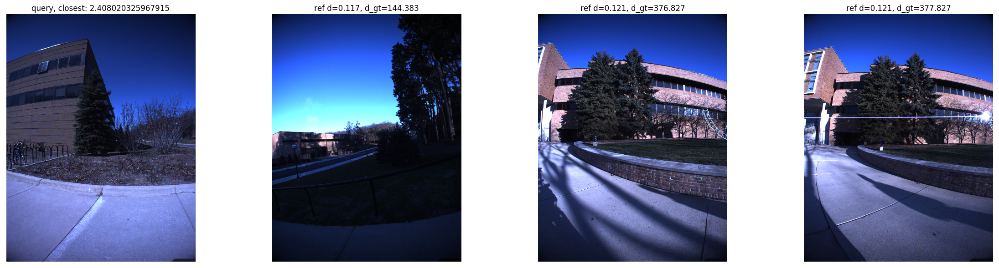

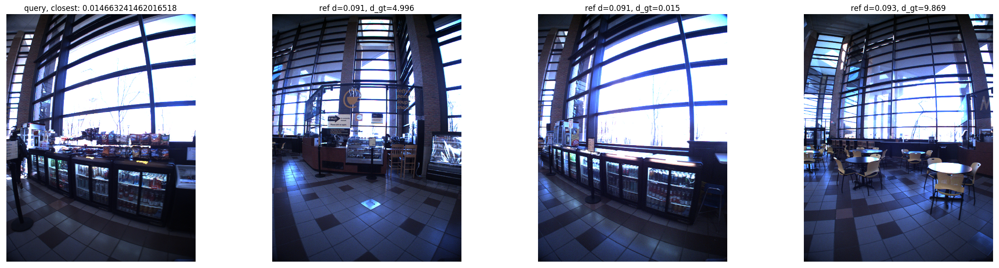

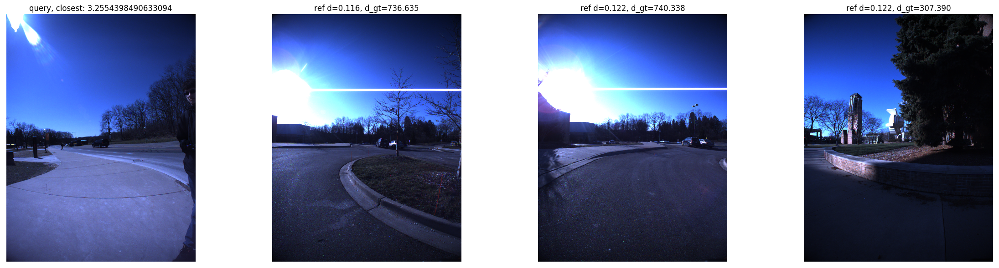

In [6]:
n_test = 10
thresh = 0.8
#np.random.seed(1)
test_idx = np.random.choice(range(query_poses.shape[0]), size=n_test)
for idx in test_idx:
    dist, matches = ref_tree.query(query_descriptors_projected[idx], k=3) #, distance_upper_bound=thresh)
    gt_dist = [np.linalg.norm([query_poses[s][idx] - ref_poses[s][i] for s in ['x', 'y']]) for i in matches]
    closest = np.min(
        np.linalg.norm(
            np.array([query_poses[s][idx] for s in ['x', 'y']]) - np.array([ref_poses[s] for s in ['x', 'y']]).T,
            axis=1))
    plot_imgs([imread(query_seq, query_poses['time'][idx])]+[imread(ref_seq, ref_poses['time'][i]) for i in matches],
               titles=['query, closest: {}'.format(closest)]+['ref d={:.3f}, d_gt={:.3f}'.format(d, gt_d) for d,gt_d in zip(dist, gt_dist)])